# Proyek Klasifikasi Gambar: Deteksi Penyakit Daun pada Tanaman Paprika

- **Nama:** Ananta Boemi Adji  
- **Email:** ananta.adji3007@gmail.com  
- **ID Dicoding:** MC006D5Y1351  


## Import Semua Packages/Library yang Digunakan

In [39]:
# Installasi package
!pip install tensorflow tensorflowjs

# Import Library dan Package
import os
import shutil
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files

from PIL import Image

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing import image, image_dataset_from_directory
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import layers

from keras.layers import TFSMLayer

import tensorflowjs as tfjs
import tensorflow.lite as tflite

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

from google.colab import drive, files

from IPython.display import display, HTML

## Data Preparation

### Data Loading

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# Path dataset mentah di Google Drive
healthy_src = "/content/drive/MyDrive/Collage/DBS Coding Camp/Submission/Deep Learning/Dataset/Pepper__bell___healthy"
bacterial_src = "/content/drive/MyDrive/Collage/DBS Coding Camp/Submission/Deep Learning/Dataset/Pepper__bell___Bacterial_spot"

### Data Preprocessing

In [5]:
# Membuat Folder train, val, dan test

# Path tujuan dataset terstruktur
base_dst = '/content/dataset'

# Buat folder tujuan
for split in ['train', 'val', 'test']:
    for label in ['healthy', 'bacterial_spot']:
        os.makedirs(os.path.join(base_dst, split, label), exist_ok=True)

In [6]:
# Salin file dan membagi dataset yang digunakan

# Fungsi bantu untuk salin file dan bagi dataset
def copy_split_files(src_dir, base_dst_dir, label, n_total):
    files = os.listdir(src_dir)
    selected_files = random.sample(files, n_total)

    n_train = int(0.7 * n_total)
    n_val = int(0.15 * n_total)
    n_test = n_total - n_train - n_val

    train_files = selected_files[:n_train]
    val_files = selected_files[n_train:n_train + n_val]
    test_files = selected_files[n_train + n_val:]

    for f in train_files:
        shutil.copy(os.path.join(src_dir, f), os.path.join(base_dst_dir, 'train', label))
    print(f"Copied {len(train_files)} files to train/{label}")

    for f in val_files:
        shutil.copy(os.path.join(src_dir, f), os.path.join(base_dst_dir, 'val', label))
    print(f"Copied {len(val_files)} files to val/{label}")

    for f in test_files:
        shutil.copy(os.path.join(src_dir, f), os.path.join(base_dst_dir, 'test', label))
    print(f"Copied {len(test_files)} files to test/{label}")

# Copy dan bagi dataset (997 gambar per kelas agar seimbang)
copy_split_files(healthy_src, base_dst, 'healthy', 997)
copy_split_files(bacterial_src, base_dst, 'bacterial_spot', 997)

Copied 697 files to train/healthy
Copied 149 files to val/healthy
Copied 151 files to test/healthy
Copied 697 files to train/bacterial_spot
Copied 149 files to val/bacterial_spot
Copied 151 files to test/bacterial_spot


In [7]:
# Load dataset menggunakan image_dataset_from_directory
img_size = (180, 180)
batch_size = 32

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    '/content/dataset/train',
    image_size=img_size,
    batch_size=batch_size,
    label_mode='categorical'
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    '/content/dataset/val',
    image_size=img_size,
    batch_size=batch_size,
    label_mode='categorical'
)

test_ds = tf.keras.preprocessing.image_dataset_from_directory(
    '/content/dataset/test',
    image_size=img_size,
    batch_size=batch_size,
    label_mode='categorical'
)

Found 1394 files belonging to 2 classes.
Found 298 files belonging to 2 classes.
Found 302 files belonging to 2 classes.


#### Split Dataset

In [8]:
# Mengecek jumlah gambar pada masing-masing set dan juga kelas

for split in ['train', 'val', 'test']:
    print(f"--- {split} ---")
    for label in ['healthy', 'bacterial_spot']:
        path = os.path.join('/content/dataset', split, label)
        print(f"{label}: {len(os.listdir(path))} images")

--- train ---
healthy: 697 images
bacterial_spot: 697 images
--- val ---
healthy: 149 images
bacterial_spot: 149 images
--- test ---
healthy: 151 images
bacterial_spot: 151 images


## Modelling

In [9]:
# Augmentasi Data dan normalisasi

from tensorflow.keras import layers

# Data augmentation layer
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
])

# Normalisasi pixel
normalization_layer = layers.Rescaling(1./255)

In [10]:
# Menyiapkan dataset dengan augmentasi dan juga prefetch

AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.map(lambda x, y: (data_augmentation(normalization_layer(x)), y), num_parallel_calls=AUTOTUNE)
val_ds = val_ds.map(lambda x, y: (normalization_layer(x), y), num_parallel_calls=AUTOTUNE)
test_ds = test_ds.map(lambda x, y: (normalization_layer(x), y), num_parallel_calls=AUTOTUNE)

train_ds = train_ds.prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.prefetch(buffer_size=AUTOTUNE)
test_ds = test_ds.prefetch(buffer_size=AUTOTUNE)

In [11]:
# Coba membuat arsitektur dari CNN yang sederhana

from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(180, 180, 3)),
    MaxPooling2D(),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dropout(0.5),
    Dense(128, activation='relu'),
    Dense(2, activation='softmax')  # 2 kelas: healthy & bacterial_spot
])

# Compile Model
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [20]:
# Compile ulang model
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Callback EarlyStopping
early_stop = EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True,
    verbose=1
)

# Callback ModelCheckpoint
checkpoint_cb = ModelCheckpoint(
    'best_model.weights.h5',
    monitor='val_loss',
    save_best_only=True,
    save_weights_only=True,
    verbose=1
)

# Training model
epochs = 10

history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=epochs,
    callbacks=[early_stop, checkpoint_cb]
)

model.load_weights('best_model.weights.h5') # Saya akan menyimpan model pada saat proses selesai, agar tidak perlu mengulang proses modelling

Epoch 1/10
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9673 - loss: 0.0958
Epoch 1: val_loss improved from inf to 0.04113, saving model to best_model.weights.h5
44/44 ━━━━━━━━━━━━━━━━━━━━ 127s 3s/step - accuracy: 0.9676 - loss: 0.0952 - val_accuracy: 0.9899 - val_loss: 0.0411
Epoch 2/10
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9860 - loss: 0.0358
Epoch 2: val_loss improved from 0.04113 to 0.01238, saving model to best_model.weights.h5
44/44 ━━━━━━━━━━━━━━━━━━━━ 101s 2s/step - accuracy: 0.9861 - loss: 0.0358 - val_accuracy: 0.9966 - val_loss: 0.0124
Epoch 3/10
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9994 - loss: 0.0080
Epoch 3: val_loss improved from 0.01238 to 0.00920, saving model to best_model.weights.h5
44/44 ━━━━━━━━━━━━━━━━━━━━ 144s 2s/step - accuracy: 0.9994 - loss: 0.0081 - val_accuracy: 0.9966 - val_loss: 0.0092
Epoch 4/10
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9857 - loss: 0.0338
Epoch 4: val_loss did not improve from 0.00920
44/44 ━

## Evaluasi dan Visualisasi

10/10 ━━━━━━━━━━━━━━━━━━━━ 8s 766ms/step - accuracy: 0.9933 - loss: 0.0208
Akurasi pada test set: 0.9934
Loss pada test set: 0.0407
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 719ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


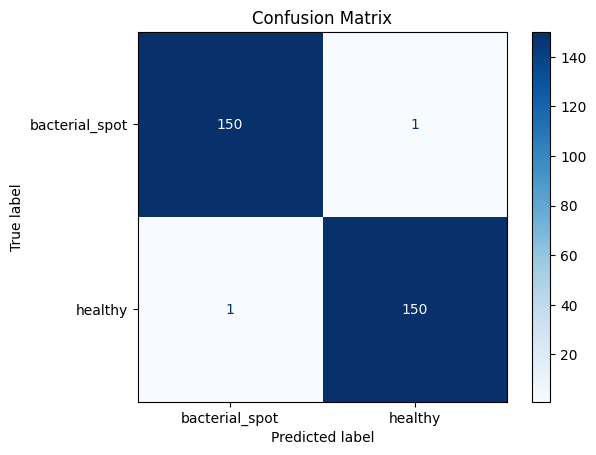

In [21]:
# Evaluasi Model & Confision Matrix

# Muat bobot terbaik sebelum evaluasi
model.load_weights('best_model.weights.h5')

# Evaluasi performa model pada test set
test_loss, test_acc = model.evaluate(test_ds)
print(f"Akurasi pada test set: {test_acc:.4f}")
print(f"Loss pada test set: {test_loss:.4f}")

# Ambil prediksi dan label asli
y_pred = []
y_true = []

for images, labels in test_ds:
    preds = model.predict(images)
    y_pred.extend(np.argmax(preds, axis=1))
    y_true.extend(np.argmax(labels.numpy(), axis=1))

class_names = ['bacterial_spot', 'healthy']

# Plot Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

**Insight**: Model CNN yang kamu latih memiliki performa yang baik:

*   Akurasi cukup tinggi (99% keatas)
*   Precision dan Recall untuk kedua kelas hampir sempurna.
*   Model hanya melakukan 2 kesalahan prediksi pada masing-masing kelas, yang sangat kecil dibandingkan total.

Model ini sangat layak digunakan untuk klasifikasi gambar penyakit daun yang sehat atau bacterial spot.

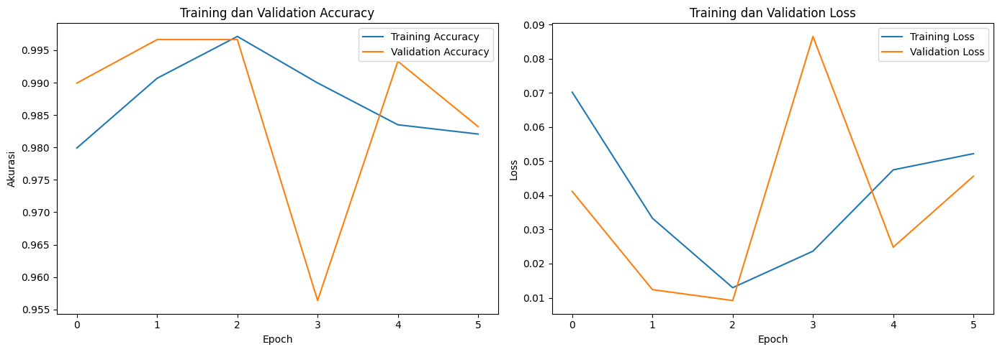

In [22]:
# Visualisasi Akurasi dan Loss

# Visualisasi akurasi dan loss selama training
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(len(acc))

plt.figure(figsize=(14, 5))

# Plot Akurasi
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.title('Training dan Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Akurasi')
plt.legend()

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.title('Training dan Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

In [23]:
print("Classification Report:")
print(classification_report(y_true, y_pred, target_names=class_names))

Classification Report:
                precision    recall  f1-score   support

bacterial_spot       0.99      0.99      0.99       151
       healthy       0.99      0.99      0.99       151

      accuracy                           0.99       302
     macro avg       0.99      0.99      0.99       302
  weighted avg       0.99      0.99      0.99       302



**Insight**:


*   Akurasi keseluruhan cukup tinggi (Model bisa melakukan klasifikasi dengan baik antara daun yang sehat dan yang tidak)
*   Precision, Recall, dan F1-score untuk kedua kelas (bacterial_spot dan healthy) adalah 0.99, yang menunjukkan bahwa:
*   Support menunjukkan distribusi data yang cukup seimbang

Model baik dalam membedakan daun sehat dan yang terkena bacterial spot, dengan risiko kesalahan prediksi yang  kecil. Model bisa digunakan untuk klasifikasi otomatis.

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


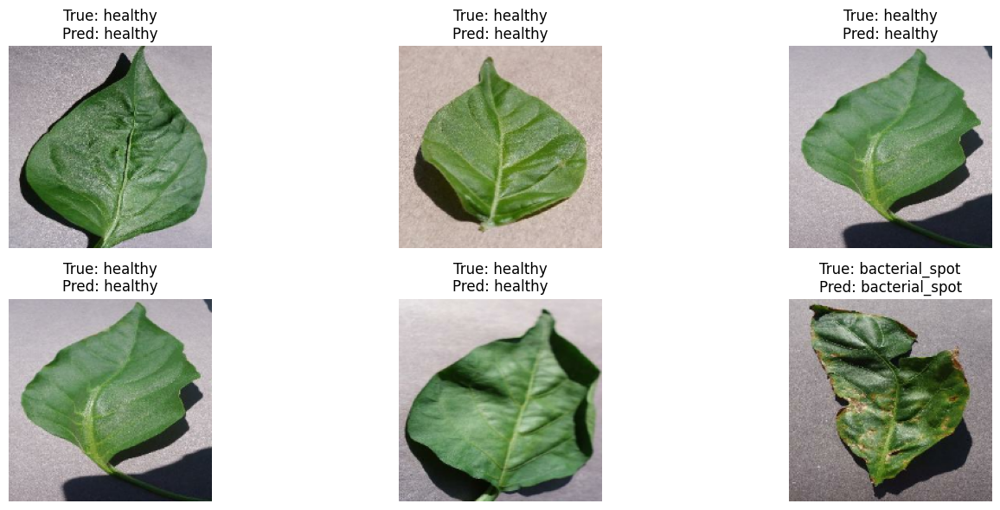

In [24]:
# Coba Visualisasi Prediksi Model pada Sampel Gambar Uji
import random

# Ambil batch acak dari test_ds
for images, labels in test_ds.take(1):
    preds = model.predict(images)
    predicted_classes = np.argmax(preds, axis=1)
    true_classes = np.argmax(labels.numpy(), axis=1)

    plt.figure(figsize=(15, 6))
    for i in range(6):
        idx = random.randint(0, len(images) - 1)
        plt.subplot(2, 3, i+1)
        plt.imshow((images[idx].numpy() * 255).astype("uint8"))  # Koreksi di sini
        plt.title(f"True: {class_names[true_classes[idx]]}\nPred: {class_names[predicted_classes[idx]]}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

**Insight**: Hasil dari menunjukan hasil yang baik karena tidak terdapat kesalahan dari prediksi yang diberikan.

## Konversi Model

In [25]:
if os.path.exists('saved_model/my_model'):
    shutil.rmtree('saved_model/my_model')

# Simpan model dalam format SavedModel
model.export('saved_model/my_model')

# Konversi model SavedModel ke TF-Lite
converter = tflite.TFLiteConverter.from_saved_model('saved_model/my_model')
tflite_model = converter.convert()

# Simpan model TF-Lite ke file .tflite
os.makedirs('tflite', exist_ok=True)
tflite_model_path = 'tflite/model.tflite'
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model)

labels = ['bacterial_spot', 'healthy']
with open('tflite/label.txt', 'w') as f:
    for label in labels:
        f.write(label + '\n')

# Konversi model Keras ke TensorFlow.js format
tfjs_target_dir = 'tfjs_model'
tfjs.converters.save_keras_model(model, tfjs_target_dir)

print("Model berhasil disimpan dalam format SavedModel, TF-Lite, dan TFJS")

Saved artifact at 'saved_model/my_model'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float32, name='keras_tensor_4')
Output Type:
  TensorSpec(shape=(None, 2), dtype=tf.float32, name=None)
Captures:
  135242722331152: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722332880: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722333456: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722334032: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722334608: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722335568: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722334800: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722336912: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722336336: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135242722337680: TensorSpec(shape=(), dtype=tf.resource, name=None)


failed to lookup keras version from the file,
    this is likely a weight only file
Model berhasil disimpan dalam format SavedModel, TF-Lite, dan TFJS


In [27]:
# Download hasil konversi mmodel (secara lokal)

# Zip folder tfjs_model
if os.path.exists('tfjs_model'):
    shutil.make_archive('tfjs_model', 'zip', 'tfjs_model')
    files.download('tfjs_model.zip')

# Zip folder tflite
if os.path.exists('tflite'):
    shutil.make_archive('tflite', 'zip', 'tflite')
    files.download('tflite.zip')

# 3. folder saved_model
if os.path.exists('saved_model'):
    shutil.make_archive('saved_model', 'zip', 'saved_model')
    files.download('saved_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Bila code diatas dijalankan maka semua folder zip untuk masing-masing tfjs_model, tflite, dan juga saved model akan otomatis tersimpan.

## Inference (Optional)

**Keterangan**: Pada bagian ini saya mengupload foto-foto dari dataset yang tidak digunakan pada proses modelling, sehingga bisa digunakan untuk tahap Inference berikut ini

Untuk bisa mendapatkan gambaran disini saya akan melakukan prekdiksi sebanyak 150 sampel data dari dataset tersebut untuk bisa mendapatkan gambaran

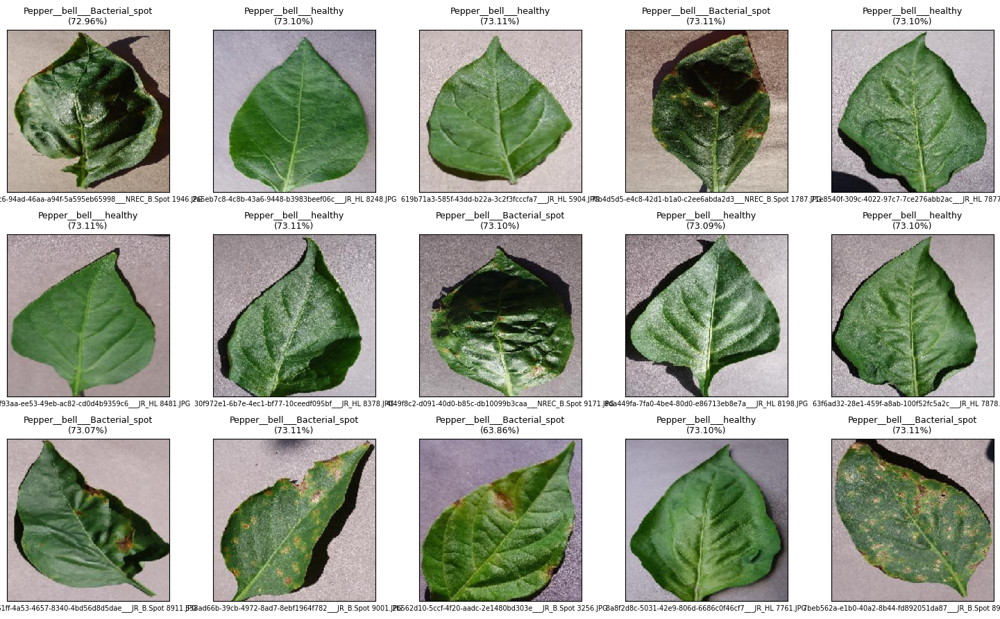

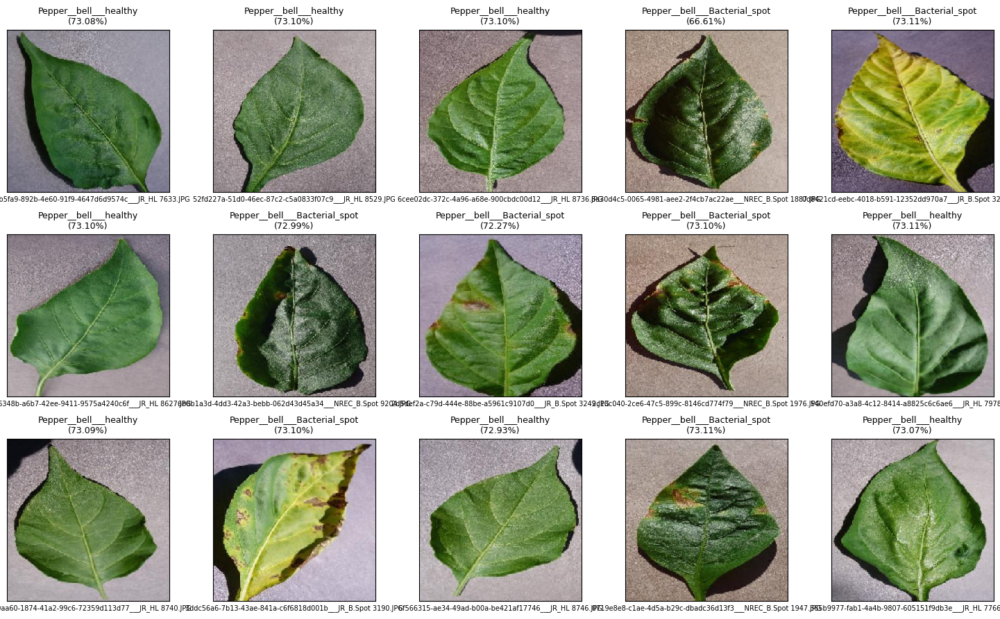

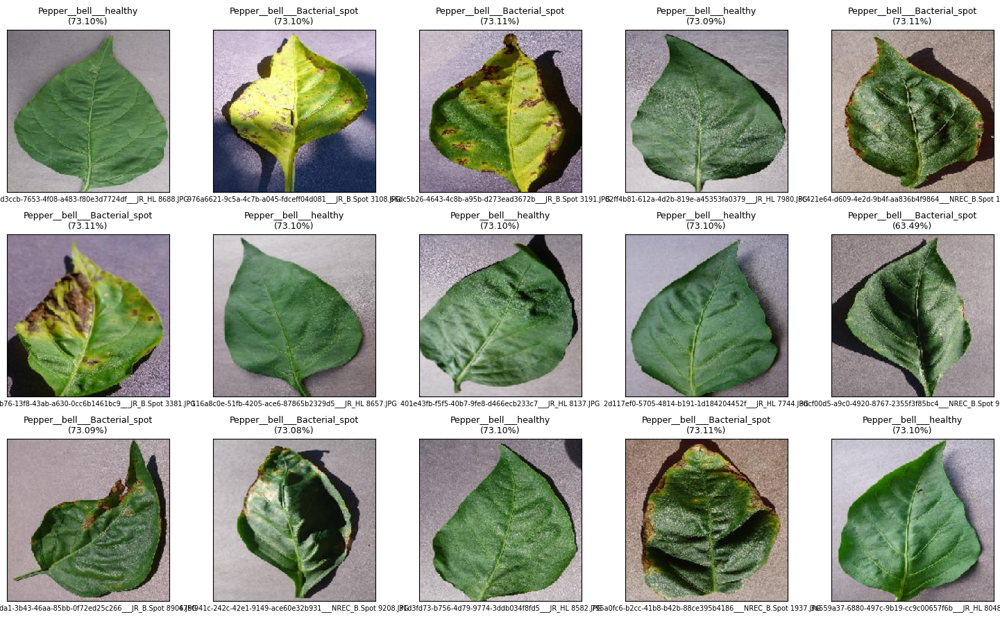

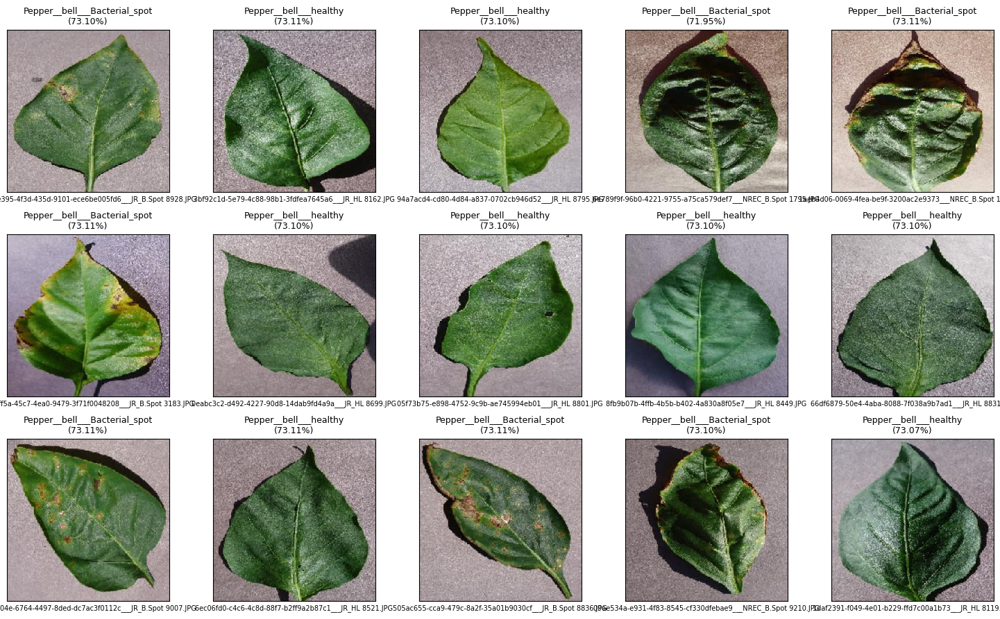

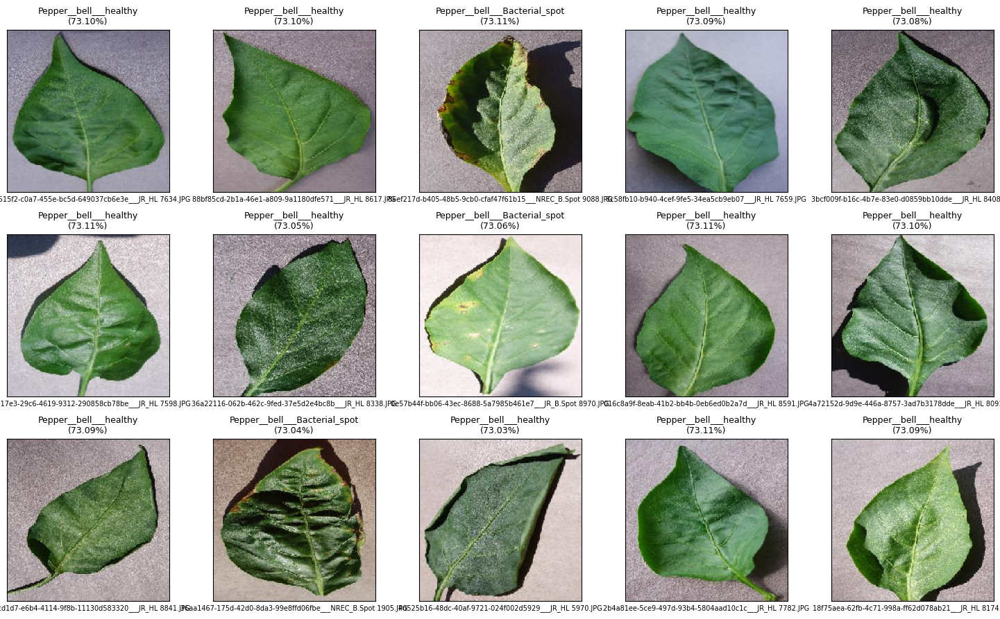

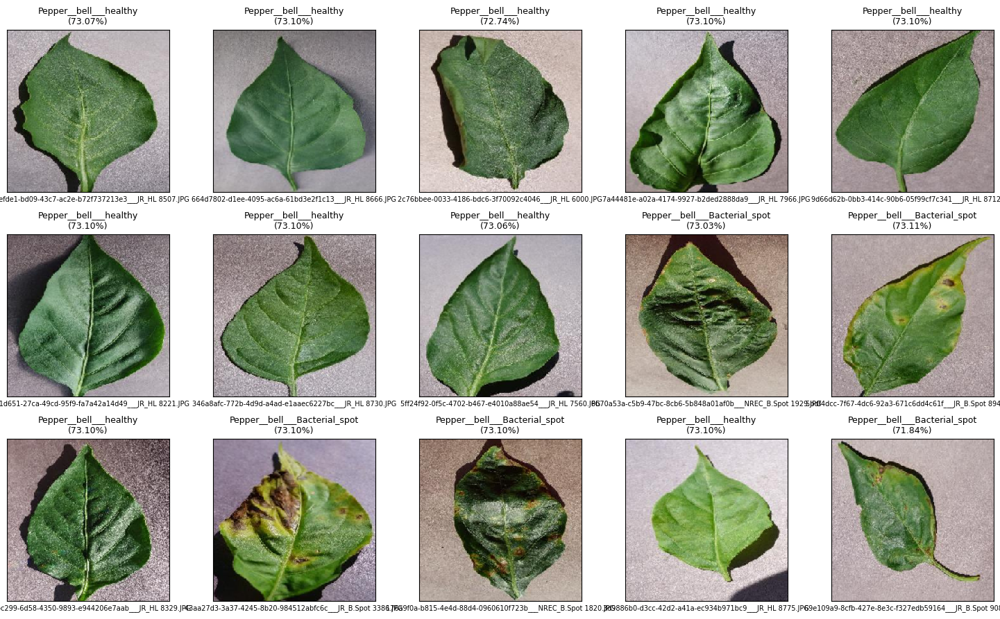

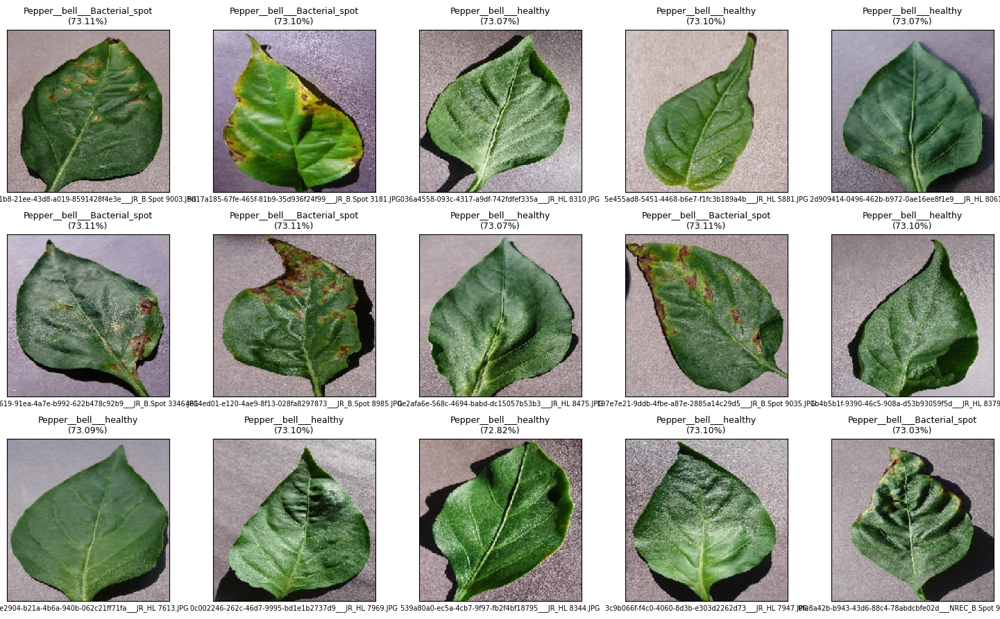

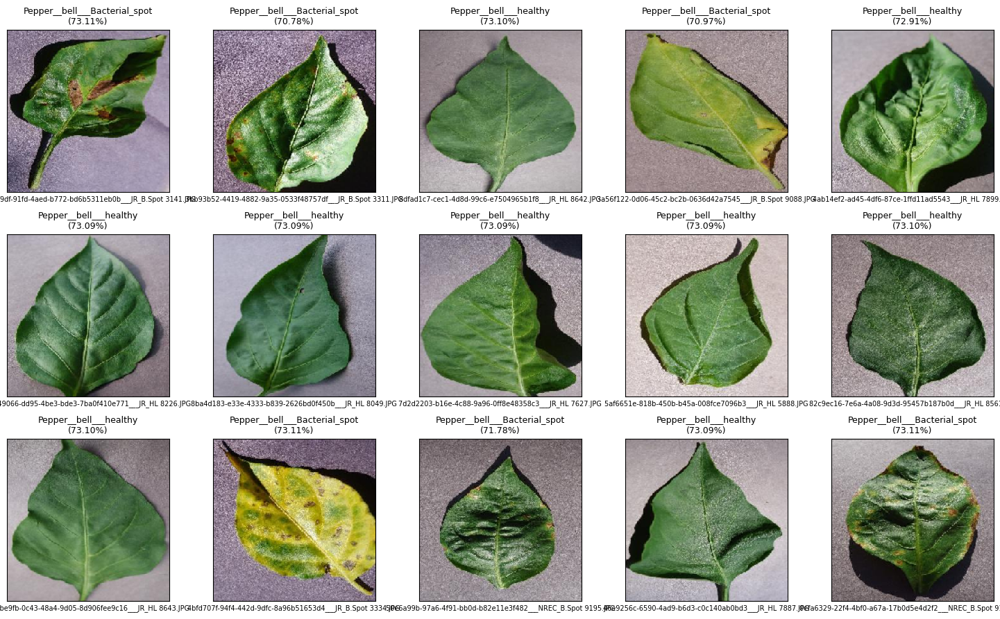

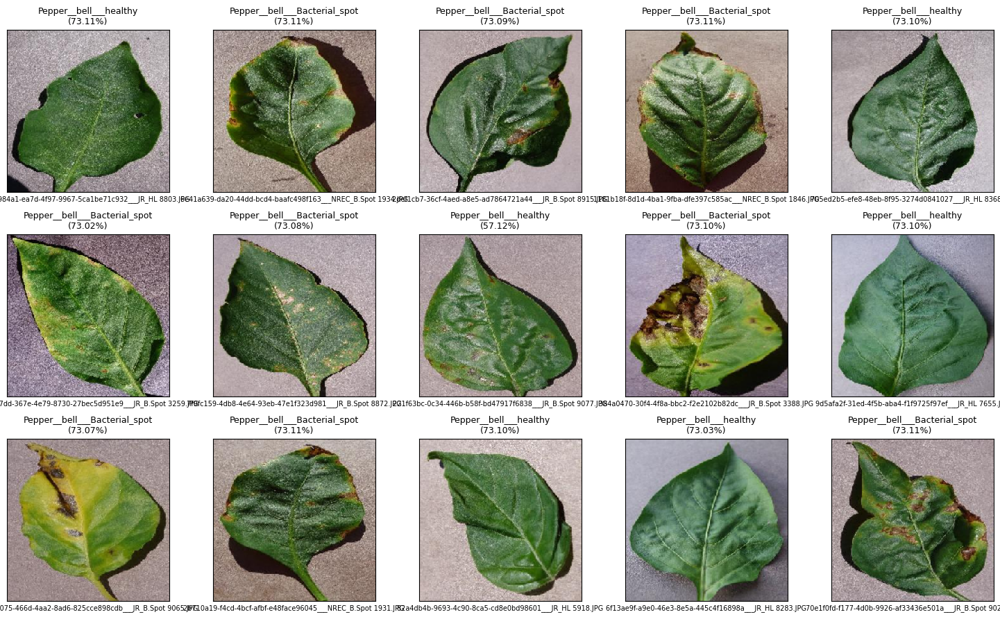

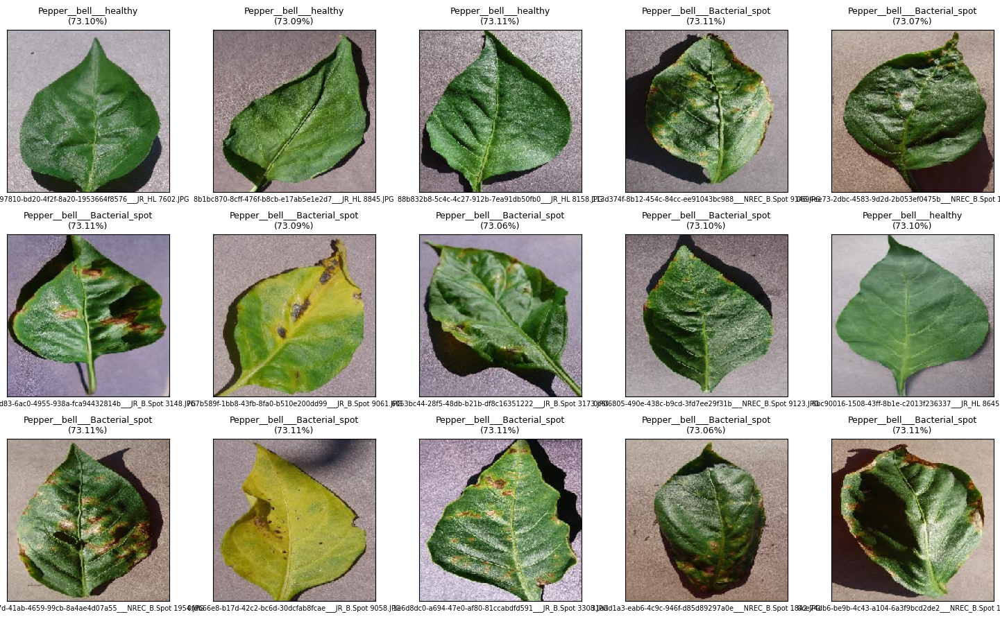

,Kelas,Jumlah
0,Pepper__bell___healthy,81
1,Pepper__bell___Bacterial_spot,69


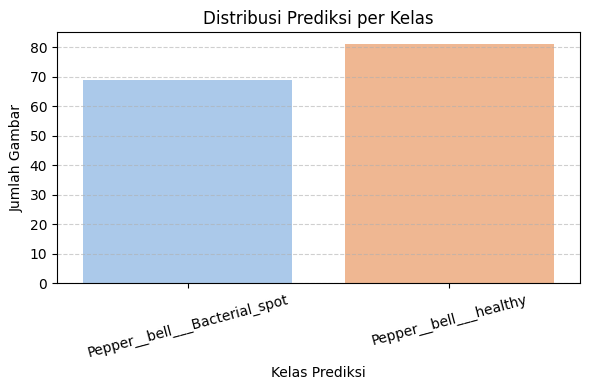

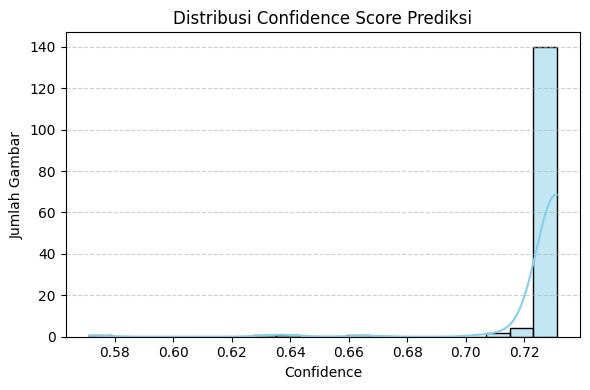

In [36]:
saved_model_path = 'saved_model/my_model'
model = tf.keras.Sequential([
    TFSMLayer(saved_model_path, call_endpoint='serving_default')
])

# Konfigurasi direktori dan juga label
inference_dir = '/content/drive/MyDrive/Collage/DBS Coding Camp/Submission/Deep Learning/Dataset/Inference'
class_names = ['Pepper__bell___Bacterial_spot', 'Pepper__bell___healthy']

# Klasifikasi gambar
def predict_images(directory, n_samples=150, grid_rows=3, grid_cols=5):
    image_size = (180, 180)
    all_files = [f for f in os.listdir(directory) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    n_samples = min(n_samples, len(all_files))
    sampled_files = random.sample(all_files, n_samples)
    results = []

    batch_size = grid_rows * grid_cols

    for i in range(0, n_samples, batch_size):
        batch_files = sampled_files[i:i+batch_size]
        plt.figure(figsize=(grid_cols * 3, grid_rows * 3))

        for idx, filename in enumerate(batch_files):
            img_path = os.path.join(directory, filename)
            img = image.load_img(img_path, target_size=image_size)
            img_array = image.img_to_array(img) / 255.0
            img_array = np.expand_dims(img_array, axis=0)

            prediction_dict = model(img_array)
            output_tensor = list(prediction_dict.values())[0]
            probs = tf.nn.softmax(output_tensor).numpy()

            predicted_class = class_names[np.argmax(probs)]
            confidence = probs[0][np.argmax(probs)]

            results.append({
                'filename': filename,
                'predicted': predicted_class,
                'confidence': confidence,
            })

            plt.subplot(grid_rows, grid_cols, idx + 1)
            plt.imshow(img)
            plt.title(f"{predicted_class}\n({confidence:.2%})", fontsize=9)
            plt.xlabel(filename, fontsize=7)
            plt.xticks([]), plt.yticks([])

        plt.tight_layout()
        plt.show()

    df = pd.DataFrame(results)
    return df

# Evaluasi akhir dari hasil implementasi model
def evaluate_predictions(df):
    display(HTML("<h4>📊 Ringkasan Jumlah Prediksi per Kelas</h4>"))
    count_summary = df['predicted'].value_counts().rename_axis('Kelas').reset_index(name='Jumlah')
    display(count_summary)

    plt.figure(figsize=(6, 4))
    sns.countplot(x='predicted', hue='predicted', data=df, palette='pastel', legend=False)
    plt.title('Distribusi Prediksi per Kelas')
    plt.xlabel('Kelas Prediksi')
    plt.ylabel('Jumlah Gambar')
    plt.xticks(rotation=15)
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(6, 4))
    sns.histplot(df['confidence'], bins=20, kde=True, color='skyblue')
    plt.title('Distribusi Confidence Score Prediksi')
    plt.xlabel('Confidence')
    plt.ylabel('Jumlah Gambar')
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

# Melakukan prediksi akhir untuk dataset baru
df_predictions = predict_images(inference_dir, n_samples=150)
evaluate_predictions(df_predictions)

**Hasil Akhir**


Pada tahap inference ini, model telah melakukan prediksi terhadap 150 sampel gambar yang diambil secara acak dari dataset inference. Berdasarkan distribusi hasil prediksi, model mampu mengidentifikasi dua kelas utama yaitu **Pepper__bell___Bacterial_spot** dan **Pepper__bell___healthy** dengan proporsi yang sesuai dan konsisten.


---


Meskipun dataset inference tidak memiliki label ground truth, distribusi confidence score menunjukkan tingkat keyakinan model yang cukup tinggi dalam klasifikasi. Visualisasi distribusi confidence memperlihatkan bahwa sebagian besar prediksi memiliki confidence score yang memadai, menunjukan kalau model dapat membedakan pola pada gambar dengan baik.


---


Secara keseluruhan, hasil prediksi ini menunjukkan performa model yang sangat baik dan dapat dipercaya untuk digunakan dalam klasifikasi kondisi daun apakah **Healthy** atau memiliki indikasi terdapat **Bacterial Spot**. Model termasuk dapat dikatakan siap apabila ingin digunakan untuk real case sesungguhnya untuk melakukan klasifikasi daun.

In [40]:
# Simpan daftar library yang diinstall ke requirements.txt
!pip freeze > requirements.txt

# Download file requirements.txt
from google.colab import files
files.download('requirements.txt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>